In [9]:
import sys
import json

In [2]:
json_file = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/annotations/my_all_labels.json'
# json_file = '/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/italy_serie-a/2016-2017/2016-10-23 - 16-00 Crotone 1 - 2 Napoli/Labels-cameras.json'
with open(json_file, 'r') as fid:
    data = json.loads(fid.read())

In [3]:
import numpy as np
np.load('/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/my_i3d_features/italy_serie-aAA2016-2017AA2016-10-25_-_21-45_Genoa_3_-_0_AC_MilanAA1_224p_train.npy')

array([[0.15672174, 0.21815909, 0.10911534, ..., 0.01606672, 0.0263116 ,
        0.11380754],
       [0.38294205, 0.23164453, 0.06575505, ..., 0.01205831, 0.01135835,
        0.22873133],
       [0.1828752 , 0.20128502, 0.08300638, ..., 0.0869701 , 0.01054851,
        0.08876468],
       ...,
       [0.2392009 , 0.24383247, 0.10545314, ..., 0.06113697, 0.11703408,
        0.23647046],
       [0.24562943, 0.54626465, 0.06083984, ..., 0.02311238, 0.08518148,
        0.16350734],
       [0.27606508, 0.43758824, 0.12224937, ..., 0.03025413, 0.08150242,
        0.15298381]])

In [3]:
json_file = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/thumos/annotations/thumos14.json'
# json_file = '/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/italy_serie-a/2016-2017/2016-10-23 - 16-00 Crotone 1 - 2 Napoli/Labels-cameras.json'
with open(json_file, 'r') as fid:
    data = json.loads(fid.read())

#### Copy the part of the files used to training and testing.

In [3]:
import os
import shutil

# Define source and target directories
source_dir = "/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/"
target_dir = "/home/csgrad/akumar58/soccernet/spotting_data/data_official_I3D/"
if not os.path.exists(target_dir):
    os.makedirs(target_dir)

# Define the pattern for file names
pattern = "1_I3D.npy"
tmp_source = []
tmp_target = []

# Loop through the files in the source directory and its subdirectories
for root, dirs, files in os.walk(source_dir):
    for file in files:
        if file.endswith(pattern):
            abs_path = '/'.join(os.path.join(root, file).split("/")[7:])
            new_abs_path = abs_path.replace("/", "AA").replace(" ", "_")
            
            tmp_source.append(abs_path)
            tmp_target.append(new_abs_path)
            # Define the source and target file paths
            source_file = os.path.join(root, file)
            target_file = os.path.join(target_dir, new_abs_path)

            # Copy the file from the source directory to the target directory
            shutil.copy(source_file, target_file)

In [6]:
import numpy as np
fs = []
for root, dirs, files in os.walk(target_dir):
    for file in files:
        # if file.endswith(pattern):
            abs_path = os.path.join(root, file)
            fs.append(abs_path)
            sz = os.path.getsize(abs_path)
            if sz < 8700000:
                print(sz, abs_path)
            try:
                data = np.load(abs_path)
            except Exception as e:
                print(e)
                print(abs_path)

8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/spain_laligaAA2014-2015AA2015-04-11_-_17-00_Real_Madrid_3_-_0_EibarAA2_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/spain_laligaAA2016-2017AA2017-03-18_-_18-15_Ath_Bilbao_1_-_2_Real_MadridAA1_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/spain_laligaAA2016-2017AA2017-03-12_-_18-15_Dep._La_Coruna_2_-_1_BarcelonaAA1_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/italy_serie-aAA2016-2017AA2016-11-06_-_17-00_Palermo_1_-_2_AC_MilanAA1_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/italy_serie-aAA2016-2017AA2016-10-26_-_21-45_Napoli_2_-_0_EmpoliAA2_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/italy_serie-aAA2016-2017AA2017-05-14_-_21-45_AS_Roma_3_-_1_JuventusAA1_224p.npy
8634496 /home/csgrad/akumar58/soccernet/spotting_data/data_part/germany_bundesligaAA2016-2017AA2017-03-17_-_22-30_Dortmund_1_-_

In [41]:
ls = []
for f in fs:
    ls.append(f.split("/")[-1])
    #     assert not os.path.exists('*'.join((f.split("/")[-1]).split('*')[:-1])+'*1_224p.npy')
    #     miss.append(f)
    # print(f)
    

In [56]:
ms = []
for l in ls:
    # if 'AA' in l:
    ms.append('AA'.join(l.split('#')))
    # tmp = '#'.join(l.split('#')[:-1])+'#1_22p.npy'
    # if tmp in ls:
    #     print('')
    # else:
    #     print(l)

In [58]:
for i in range(0, len(ms)):
    if ms[i].split('AA') == ls[i].split('#'):
        print("yes")
    else:
        assert False

yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes


In [8]:
data['database'][list(data['database'].keys())[0]]

{'subset': 'Test',
 'duration': 33.83,
 'fps': 30.0,
 'annotations': [{'label': 'CricketBowling',
   'segment': [0.2, 1.1],
   'segment(frames)': [6.0, 33.0],
   'label_id': 5},
  {'label': 'CricketBowling',
   'segment': [11.4, 12.2],
   'segment(frames)': [342.0, 366.0],
   'label_id': 5},
  {'label': 'CricketBowling',
   'segment': [18.6, 20.8],
   'segment(frames)': [558.0, 624.0],
   'label_id': 5},
  {'label': 'CricketBowling',
   'segment': [28.3, 29.7],
   'segment(frames)': [849.0, 891.0],
   'label_id': 5},
  {'label': 'CricketShot',
   'segment': [1.0, 1.5],
   'segment(frames)': [30.0, 45.0],
   'label_id': 6},
  {'label': 'CricketShot',
   'segment': [20.8, 22.3],
   'segment(frames)': [624.0, 669.0],
   'label_id': 6},
  {'label': 'CricketShot',
   'segment': [30.3, 31.7],
   'segment(frames)': [909.0, 951.0],
   'label_id': 6}]}

In [73]:
data['annotations'][2]

{'change_type': 'logo',
 'gameTime': '1 - 04:25',
 'label': 'Close-up player or field referee',
 'link': {'half': '1',
  'label': 'Shots off target',
  'position': '243195',
  'team': 'away',
  'time': '04:03',
  'visibility': 'visible'},
 'position': '265503',
 'replay': 'replay'}

In [10]:
from pathlib import Path

In [11]:
cnt = 0
total = 0
cnt1 = 0
cnt2 = 0
input_dir = "/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/"
a =set()
for json_file in Path(input_dir).rglob('*/Labels-v2.json'):
        with open(json_file, 'r') as fid:
            data = json.loads(fid.read())
        # for annot in data['annotations']:
        #     a.add(annot['label'])
            # if 'link' in list(annot.keys()):
            #     # print(annot['link'])
            #     # print(annot['position'])
            #     # print(abs(int(annot['link']['position'])-int(annot['position'])))
            #     cnt+=1
            #     if annot['replay'] == 'replay':
            #         cnt1+=1

In [12]:
data

{'UrlLocal': 'england_epl/2014-2015/2015-05-17 - 18-00 Manchester United 1 - 1 Arsenal/',
 'UrlYoutube': '',
 'annotations': [{'gameTime': '1 - 00:00',
   'label': 'Kick-off',
   'position': '0',
   'team': 'home',
   'visibility': 'visible'},
  {'gameTime': '1 - 01:16',
   'label': 'Ball out of play',
   'position': '76376',
   'team': 'not applicable',
   'visibility': 'visible'},
  {'gameTime': '1 - 01:26',
   'label': 'Throw-in',
   'position': '86245',
   'team': 'away',
   'visibility': 'not shown'},
  {'gameTime': '1 - 03:48',
   'label': 'Ball out of play',
   'position': '228671',
   'team': 'not applicable',
   'visibility': 'visible'},
  {'gameTime': '1 - 03:54',
   'label': 'Throw-in',
   'position': '234838',
   'team': 'away',
   'visibility': 'visible'},
  {'gameTime': '1 - 04:11',
   'label': 'Ball out of play',
   'position': '251234',
   'team': 'not applicable',
   'visibility': 'visible'},
  {'gameTime': '1 - 04:17',
   'label': 'Throw-in',
   'position': '257105',


In [12]:
classes = {}
i = 1
for c in a :
    print(c)
    classes[c] = i
    i+=1

Goal
Corner
Indirect free-kick
Kick-off
Yellow->red card
Shots off target
Penalty
Foul
Shots on target
Substitution
Clearance
Offside
Direct free-kick
Yellow card
Ball out of play
Red card
Throw-in


In [13]:
classes

{'Goal': 1,
 'Corner': 2,
 'Indirect free-kick': 3,
 'Kick-off': 4,
 'Yellow->red card': 5,
 'Shots off target': 6,
 'Penalty': 7,
 'Foul': 8,
 'Shots on target': 9,
 'Substitution': 10,
 'Clearance': 11,
 'Offside': 12,
 'Direct free-kick': 13,
 'Yellow card': 14,
 'Ball out of play': 15,
 'Red card': 16,
 'Throw-in': 17}

In [6]:
import os
import shutil
import glob

def get_files_recursively(start_directory, filter_extension=''):
    files = glob.glob(f'{start_directory}/**/*{filter_extension}', 
                   recursive = True)
    return files

def selective_copy(source, target, file_extension=None):
    if not os.path.exists(target):
        os.makedirs(target)
    file_names = get_files_recursively(source, file_extension)
    for file in file_names:
        if file.split("/")[-1] == "1_224p.npy" or file.split("/")[-1] == "2_224p.npy":
            targetfile = target
            fname_parts = file.split("/")[-4:]
            fname_parts[2] = fname_parts[2].replace(" ", "_")
            new_file = '_'.join(fname_parts)
            new_file = os.path.join(target, new_file)
            shutil.copyfile(file, new_file)

# if __name__ == "__main__":
#     selective_copy("/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/",
#                    "/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/tmp/i3d_features",
#                    ".npy")

In [47]:
files = get_files_recursively(start_directory = "/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/my_i3d_features", filter_extension='*.npy')

In [2]:
import numpy as np
f = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/official_i3d_features/spain_laligaAA2016-2017AA2017-05-21_-_21-00_Malaga_0_-_2_Real_MadridAA1_I3D_train.npy'
# for f in files:
data = np.load(f)
# if data.ndim != 2:
#     print(f)

In [3]:
data.shape

(5395, 1024)

In [40]:
data = np.load("/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/england_epl/2015-2016/2016-01-24 - 19-00 Arsenal 0 - 1 Chelsea/2_224p.npy")

In [35]:
data.shape

(0,)

In [16]:
train_files = files[:70]
test_files = files[70:100]

In [19]:
for file in train_files:
    os.rename(file, file.split(".")[0]+"_train.npy")
for file in test_files:
    os.rename(file, file.split(".")[0]+"_test.npy")

In [1]:
import json
# json_file = '/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/tmp/all_labels.json'
# json_file = '/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/annotations/all_labels.json'
json_file = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/thumos/annotations/thumos14.json'
with open(json_file, 'r') as fid:
    data = json.loads(fid.read())

In [9]:

s = set()
for f,v in data['database'].items():
    for a in v['annotations']:
        s.add(a['label'])

In [11]:
len(s)

20

In [28]:
data = np.load('/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/my_i3d_features/england_eplAA2015-2016AA2015-10-03_-_17-00_Manchester_City_6_-_1_Newcastle_UtdAA2_224p_train.npy')

In [29]:
data.shape

(0,)

In [3]:
import numpy as np
mp = np.load("/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/thumos/i3d_features/video_test_0000004.npy")

In [7]:
files = get_files_recursively(start_directory = "/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/thumos/i3d_features/", filter_extension='*.npy')

In [8]:
for f in files:
    print(np.load(f).shape)

(340, 2048)
(642, 2048)
(8805, 2048)
(1143, 2048)
(6337, 2048)
(752, 2048)
(1310, 2048)
(6352, 2048)
(1330, 2048)
(608, 2048)
(1009, 2048)
(1267, 2048)
(504, 2048)
(1026, 2048)
(1737, 2048)
(743, 2048)
(2111, 2048)
(147, 2048)
(222, 2048)
(824, 2048)
(515, 2048)
(1168, 2048)
(1353, 2048)
(390, 2048)
(2267, 2048)
(1217, 2048)
(1133, 2048)
(317, 2048)
(1260, 2048)
(830, 2048)
(308, 2048)
(1569, 2048)
(1437, 2048)
(1475, 2048)
(2014, 2048)
(503, 2048)
(160, 2048)
(5089, 2048)
(1114, 2048)
(766, 2048)
(774, 2048)
(819, 2048)
(5653, 2048)
(592, 2048)
(1365, 2048)
(1159, 2048)
(1297, 2048)
(905, 2048)
(1067, 2048)
(1731, 2048)
(147, 2048)
(768, 2048)
(2448, 2048)
(1428, 2048)
(1610, 2048)
(794, 2048)
(504, 2048)
(4317, 2048)
(1336, 2048)
(1368, 2048)
(576, 2048)
(2065, 2048)
(1301, 2048)
(4856, 2048)
(655, 2048)
(971, 2048)
(292, 2048)
(284, 2048)
(965, 2048)
(281, 2048)
(3720, 2048)
(2133, 2048)
(2098, 2048)
(755, 2048)
(3926, 2048)
(229, 2048)
(1453, 2048)
(533, 2048)
(5655, 2048)
(1023, 2

In [9]:
files = get_files_recursively(start_directory = "/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/my_i3d_features", filter_extension='*.npy')


In [10]:
for f in files:
    print(np.load(f).shape)

(1137, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1076, 1024)
(1128, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1107, 1024)
(1054, 1024)
(1054, 1024)
(1080, 1024)
(1054, 1024)
(1086, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1099, 1024)
(1057, 1024)
(1054, 1024)
(1054, 1024)
(1231, 1024)
(1054, 1024)
(1054, 1024)
(1078, 1024)
(1167, 1024)
(1054, 1024)
(1061, 1024)
(1086, 1024)
(1054, 1024)
(1103, 1024)
(1111, 1024)
(1121, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1234, 1024)
(1054, 1024)
(1069, 1024)
(1070, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1136, 1024)
(1054, 1024)
(1066, 1024)
(1128, 1024)
(1149, 1024)
(1080, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1123, 1024)
(1167, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1103, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1069, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1054, 1024)
(1141, 1024)

In [4]:
data = np.load('/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/england_epl/2014-2015/2015-02-21 - 18-00 Crystal Palace 1 - 2 Arsenal/1_I3D.npy')

In [5]:
data.shape

(5529, 1024)

In [11]:
files = get_files_recursively(start_directory = "/home/csgrad/mbhosale/SoccerNet-Action-Spotting/actionformer_release/data/soccernet/official_i3d_features", filter_extension='*.npy')


In [12]:
for f in files:
    print(np.load(f).shape)

(5395, 1024)
(5395, 1024)
(5469, 1024)
(5467, 1024)
(5395, 1024)
(5395, 1024)
(5497, 1024)
(5451, 1024)
(5865, 1024)
(5423, 1024)
(5395, 1024)
(5887, 1024)
(5655, 1024)
(5631, 1024)
(5605, 1024)
(6317, 1024)
(5395, 1024)
(5755, 1024)
(6001, 1024)
(5511, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5557, 1024)
(5683, 1024)
(5395, 1024)
(5395, 1024)
(5759, 1024)
(5395, 1024)
(5395, 1024)
(5475, 1024)
(5745, 1024)
(5395, 1024)
(5395, 1024)
(5957, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5635, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5767, 1024)
(5395, 1024)
(5997, 1024)
(5395, 1024)
(5395, 1024)
(5523, 1024)
(5395, 1024)
(5409, 1024)
(5395, 1024)
(5505, 1024)
(5395, 1024)
(5761, 1024)
(5395, 1024)
(5663, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5395, 1024)
(5431, 1024)
(5395, 1024)
(5637, 1024)
(5395, 1024)
(5479, 1024)

In [1]:
import json

In [2]:
def retrun_num_smaples(f):
    with open(f, 'r') as fd:
        data = json.loads(fd.read())
    games = list(data.keys())
    cnt = 0
    for game in games:
        years = list(data[game].keys())
        for year in years:
            cnt+=len(data[game][year])
    return cnt

In [3]:
train_samples_json = '/home/csgrad/mbhosale/anaconda3/envs/sn-spotting1/lib/python3.10/site-packages/SoccerNet/data/SoccerNetGamesTrain.json'
test_samples_json = '/home/csgrad/mbhosale/anaconda3/envs/sn-spotting1/lib/python3.10/site-packages/SoccerNet/data/SoccerNetGamesTest.json'
validation_samples_json = '/home/csgrad/mbhosale/anaconda3/envs/sn-spotting1/lib/python3.10/site-packages/SoccerNet/data/SoccerNetGamesValid.json'

In [2]:
# Code to rename the files from train/test/validation split to original split
files = []
import os
d = "/home/csgrad/akumar58/soccernet/for_baidu/features"
for f in os.listdir(d):
    parts = f.split("AA")
    second = "_".join(parts[-1].split("_")[:-1])
    first = "AA".join(parts[:-1])
    target = first + "AA" + second + ".npy"
    # print(target)
    os.rename(os.path.join(d, f), os.path.join(d, target))

In [1]:
import os
import pickle
import pandas as pd
def load_results_from_pkl(filename):
    # load from pickle file
    assert os.path.isfile(filename)
    with open(filename, "rb") as f:
        results = pickle.load(f)
    return results

In [2]:
def results_to_dict(results):
    """convert result arrays into dict used by json files"""
    # video ids and allocate the dict
    vidxs = sorted(list(set(results['video-id'])))
    results_dict = {}
    for vidx in vidxs:
        results_dict[vidx] = []

    # fill in the dict
    for vidx, start, end, label, score in zip(
        results['video-id'],
        results['t-start'],
        results['t-end'],
        results['label'],
        results['score']
    ):
        results_dict[vidx].append(
            {
                "label" : int(label),
                "score" : float(score),
                "segment": [float(start), float(end)],
            }
        )
    return results_dict

In [6]:
pkl_folder = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/ckpt/soccernet_i3d_reproduce/ckpts_without_reg_loss/'

pkl = os.path.join(pkl_folder, 'eval_results.pkl')
res = load_results_from_pkl(pkl)
# res = results_to_dict(res)

<Axes: >

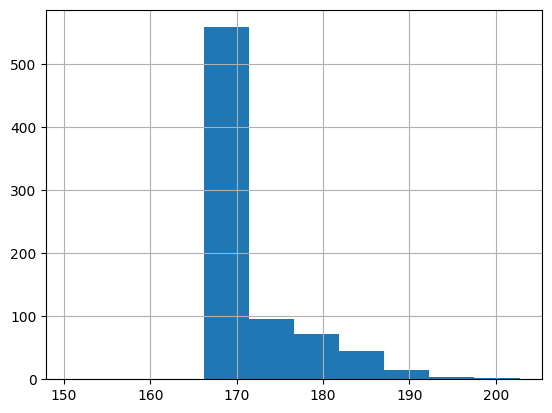

In [16]:
res = pd.DataFrame(res)
(res.groupby('video-id')['t-end'].max() - res.groupby('video-id')['t-start'].min()).hist()

In [15]:
res.groupby('video-id')['t-end'].max()

video-id
england_eplAA2014-2015AA2015-05-17_-_18-00_Manchester_United_1_-_1_ArsenalAA1_224p_test    2687.000000
england_eplAA2014-2015AA2015-05-17_-_18-00_Manchester_United_1_-_1_ArsenalAA2_224p_test    3010.000000
england_eplAA2015-2016AA2015-08-16_-_18-00_Manchester_City_3_-_0_ChelseaAA1_224p_test      2780.000000
england_eplAA2015-2016AA2015-08-16_-_18-00_Manchester_City_3_-_0_ChelseaAA2_224p_test      2803.000000
england_eplAA2015-2016AA2015-08-23_-_15-30_West_Brom_2_-_3_ChelseaAA1_224p_test            2663.000000
                                                                                              ...     
spain_laligaAA2016-2017AA2017-04-02_-_17-15_Real_Madrid_3_-_0_AlavesAA2_224p_test          2689.000000
spain_laligaAA2016-2017AA2017-04-08_-_21-45_Malaga_2_-_0_BarcelonaAA1_224p_test            2705.000000
spain_laligaAA2016-2017AA2017-04-08_-_21-45_Malaga_2_-_0_BarcelonaAA2_224p_test            2697.000000
spain_laligaAA2016-2017AA2017-04-26_-_20-30_Barcelona_7_-_1_Osas

In [39]:
pkl_folder = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/ckpt_wt_bd_regloss/soccernet_baidu_reproduce/'
pkl = os.path.join(pkl_folder, 'eval_results.pkl')
res = load_results_from_pkl(pkl)
res = pd.DataFrame(res)
grouped_res = res.groupby(['video-id', 'label'])
sorted_res = grouped_res.apply(lambda x: x.sort_values('t-start'))
# res = results_to_dict(res)    

In [40]:
for id in sorted_res['video-id']

SyntaxError: expected ':' (400888749.py, line 1)

In [72]:
pkl_folder = '/home/csgrad/mbhosale/SoccerNet-Action-Spotting/ckpt_wt_bd_regloss/soccernet_baidu_reproduce/'
pkl = os.path.join(pkl_folder, 'eval_results.pkl')
res = load_results_from_pkl(pkl)
res = results_to_dict(res)

In [73]:
lens = []
for vdo in res.keys():
    lens.append(len(res[vdo]))

<Axes: >

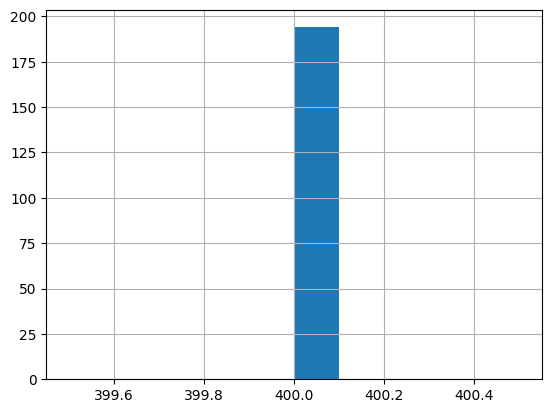

In [74]:
pd.Series(lens).hist()

In [75]:

# return final_annotations

<Axes: >

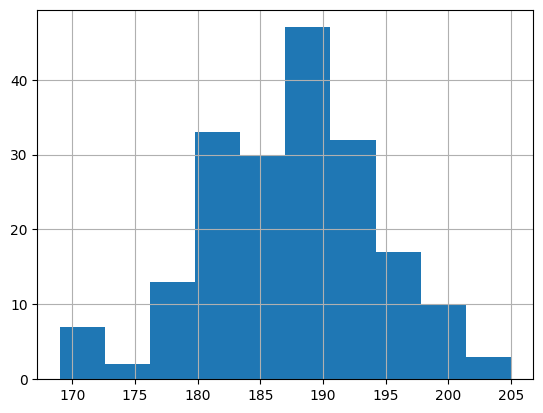

In [76]:
lens = []
for vdo in res.keys():
    lens.append(len(res[vdo]))
pd.Series(lens).hist()

In [57]:
res = load_results_from_pkl('/home/csgrad/mbhosale/SoccerNet-Action-Spotting/ckpt_wt_bd_regloss_no_sf/soccernet_baidu_reproduce/eval_results_sc.pkl')

In [58]:
# for vdo in res.keys():
vdo = list(res.keys())[0]
annotations = res[vdo]['predictions']
sorted_annotations = sorted(annotations, key=lambda x: x["position"] + (45*60*1000)*(int(x['half'])-1)) # sort with the postions by taking into accouint the game halfs.
final_annotations = []

In [59]:
delta = 5
i = 0
while i < len(sorted_annotations):
    annot = sorted_annotations[i]
    t_start = t_end = annot['position']
    t_label = annot['label']
    mx_conf = annot['confidence']
    j = i+1
    while j < len(sorted_annotations) and sorted_annotations[j]['position'] <= t_start+(delta*1000):
        if sorted_annotations[j]['label'] == t_label:
            t_end = sorted_annotations[j]['position']
            mx_conf = max(mx_conf, sorted_annotations[j]['confidence'])
        j+=1
    i = j
    annot['position']= (t_start+t_end)/2
    annot['confidence'] = mx_conf
    mm, ss = divmod(annot['position']/1000, 60)
    annot['gameTime'] = annot['half'] + " - " + f"{mm:02f}:{ss:02f}"
    final_annotations.append(annot)

In [60]:
len(sorted_annotations)

800

In [61]:
len(final_annotations)

189

In [62]:
final_annotations

[{'gameTime': '1 - 0.000000:1.750000',
  'position': 1750.0,
  'label': 'Kick-off',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.29810720682144165,
  'half': '1'},
 {'gameTime': '1 - 1.000000:14.500000',
  'position': 74500.0,
  'label': 'Ball out of play',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.6618412137031555,
  'half': '1'},
 {'gameTime': '1 - 1.000000:21.250000',
  'position': 81250.0,
  'label': 'Throw-in',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.3340400159358978,
  'half': '1'},
 {'gameTime': '1 - 1.000000:26.000000',
  'position': 86000.0,
  'label': 'Throw-in',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.41263625025749207,
  'half': '1'},
 {'gameTime': '1 - 1.000000:40.250000',
  'position': 100250.0,
  'label': 'Offside',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.250151664018631,
  'half': '1'},
 {'gameTime': '1 - 1.000000:51.000000',
  'position': 111000.0,
  'label': 'Cl

In [43]:
sorted_annotations

[{'gameTime': '1 - 0.000000:1.000000',
  'position': 1000.0,
  'label': 'Kick-off',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.09333900362253189,
  'half': '1'},
 {'gameTime': '1 - 0.000000:1.500000',
  'position': 1500.0,
  'label': 'Kick-off',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.29810720682144165,
  'half': '1'},
 {'gameTime': '1 - 0.000000:2.500000',
  'position': 2500.0,
  'label': 'Kick-off',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.07506363093852997,
  'half': '1'},
 {'gameTime': '1 - 1.000000:13.500000',
  'position': 73500.0,
  'label': 'Ball out of play',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.08440343290567398,
  'half': '1'},
 {'gameTime': '1 - 1.000000:15.500000',
  'position': 75500.0,
  'label': 'Ball out of play',
  'team': 'home',
  'visibility': 'visible',
  'confidence': 0.6618412137031555,
  'half': '1'},
 {'gameTime': '1 - 1.000000:17.500000',
  'position': 77500.0,
  'label

In [7]:
data

{'/home/csgrad/akumar58/soccernet/spotting_data/spotting_video/england_epl/2014-2015/2015-05-17 - 18-00 Manchester United 1 - 1 Arsenal': {'UrlLocal': 'england_epl/2014-2015/2015-05-17 - 18-00 Manchester United 1 - 1 Arsenal',
  'UrlYoutube': '',
  'predictions': [{'gameTime': '1 - 22.000000:39.500000',
    'position': 1359500.0,
    'label': 'Ball out of play',
    'team': 'home',
    'visibility': 'visible',
    'confidence': 0.7937383055686951,
    'half': '1'},
   {'gameTime': '1 - 26.000000:44.500000',
    'position': 1604500.0,
    'label': 'Throw-in',
    'team': 'home',
    'visibility': 'visible',
    'confidence': 0.7870360016822815,
    'half': '1'},
   {'gameTime': '1 - 9.000000:44.500000',
    'position': 584500.0,
    'label': 'Corner',
    'team': 'home',
    'visibility': 'visible',
    'confidence': 0.7744853496551514,
    'half': '1'},
   {'gameTime': '1 - 15.000000:43.500000',
    'position': 943500.0,
    'label': 'Throw-in',
    'team': 'home',
    'visibility': 'v